In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier

from scipy import stats


# Load the data
df = pd.read_csv('water_potability.csv')

# Display basic information about the dataset
print(df.info())
print(df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               2785 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          2495 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3114 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB
None
                ph     Hardness        Solids  Chloramines      Sulfate  \
count  2785.000000  3276.000000   3276.000000  3276.000000  2495.000000   
mean      7.080795   196.369496  22014.092526     7.122277   333.775777   
std       1.594320    32.879761   8768.570828     1.583085 

In [2]:
# Check for missing values
print(df.isnull().sum())

# Remove rows with missing values
df_clean = df.dropna()

print("Original dataset shape:", df.shape)
print("Clean dataset shape:", df_clean.shape)

ph                 491
Hardness             0
Solids               0
Chloramines          0
Sulfate            781
Conductivity         0
Organic_carbon       0
Trihalomethanes    162
Turbidity            0
Potability           0
dtype: int64
Original dataset shape: (3276, 10)
Clean dataset shape: (2011, 10)


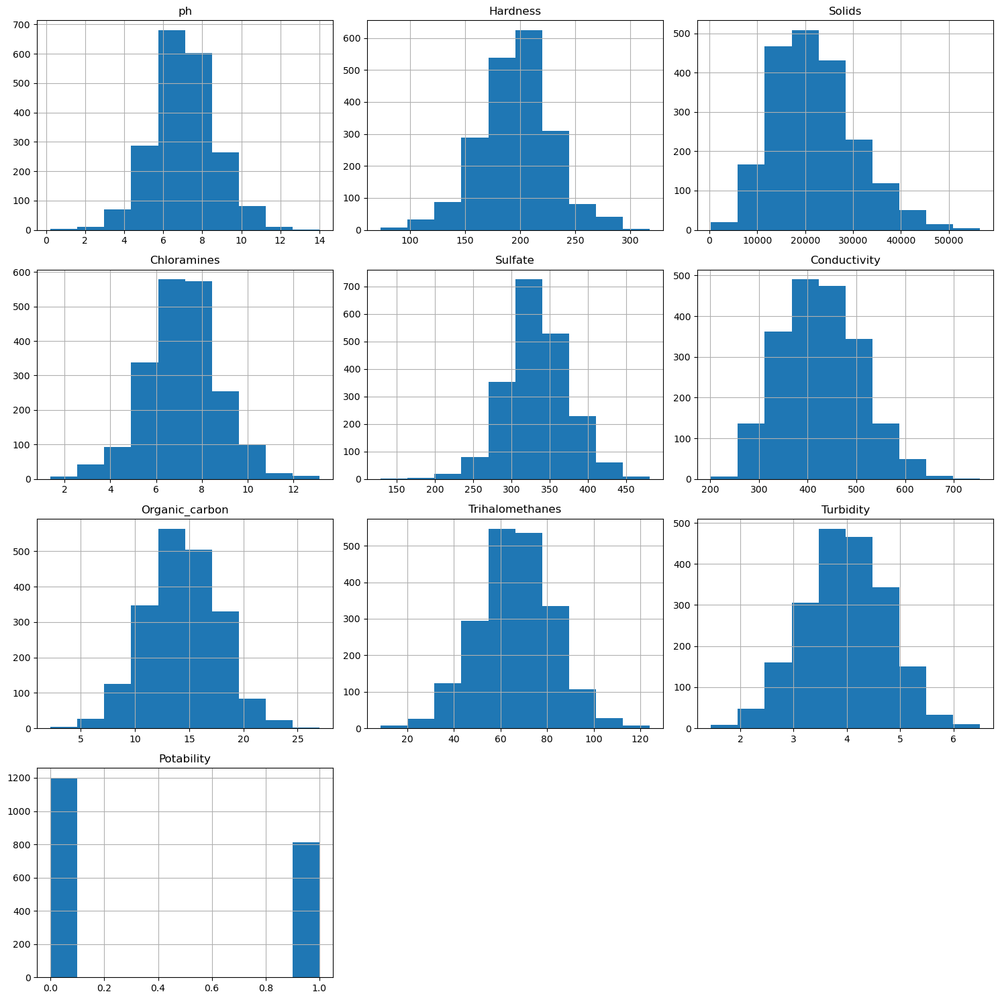

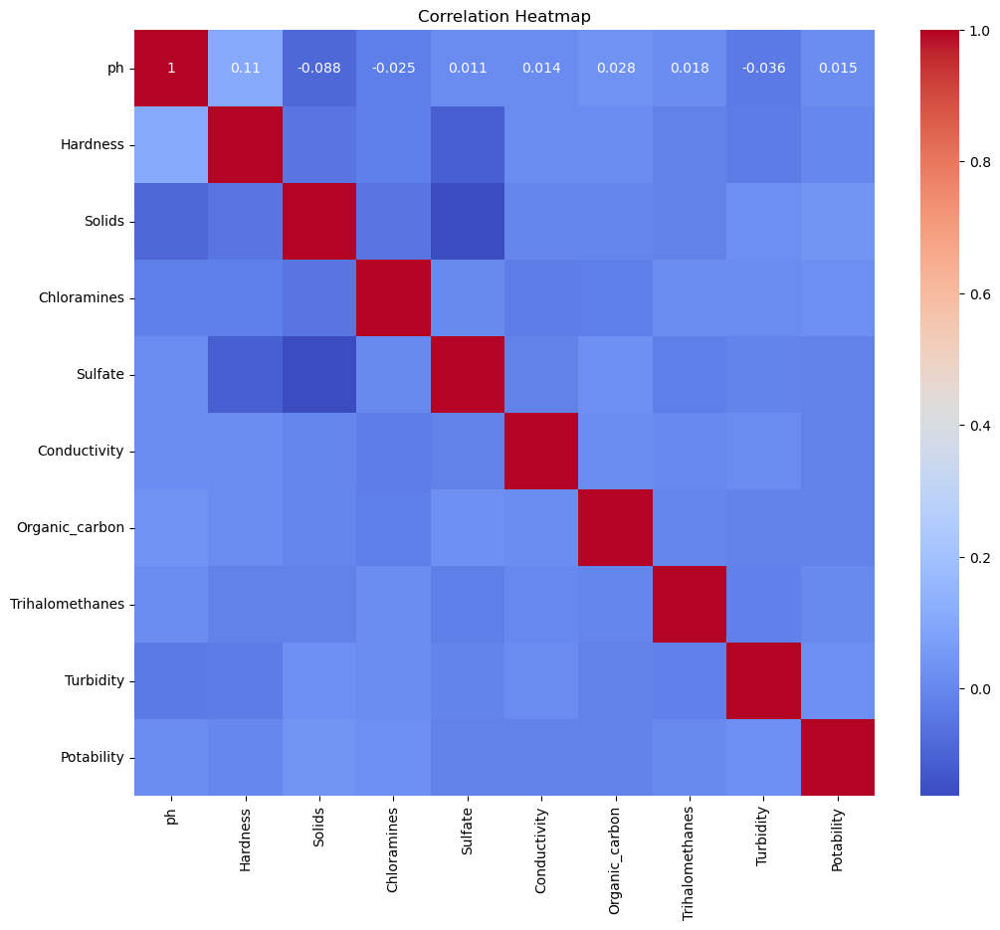

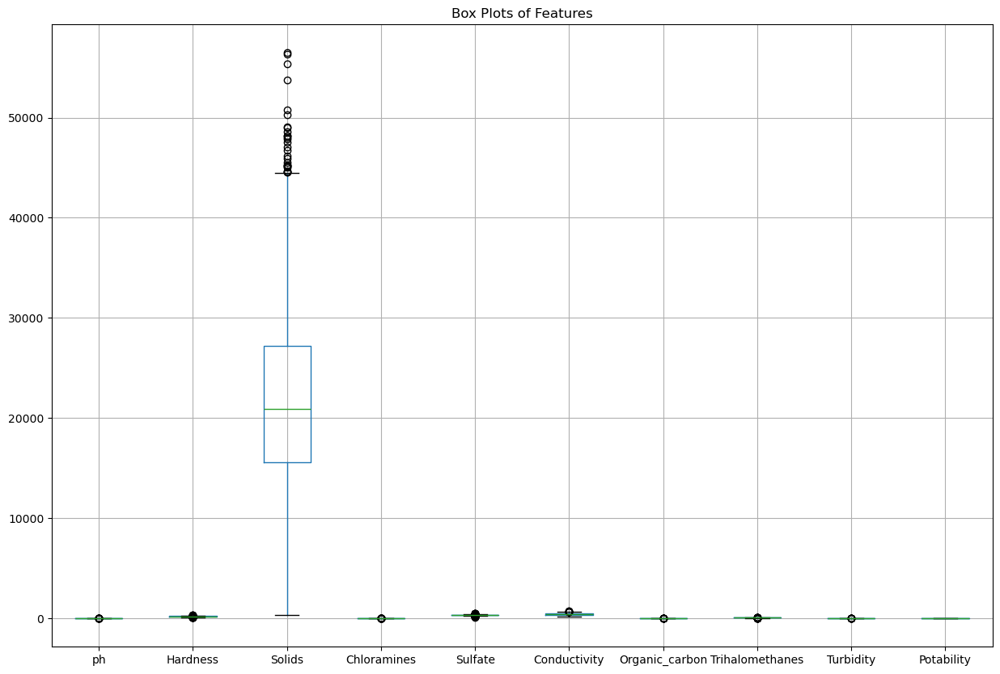

C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

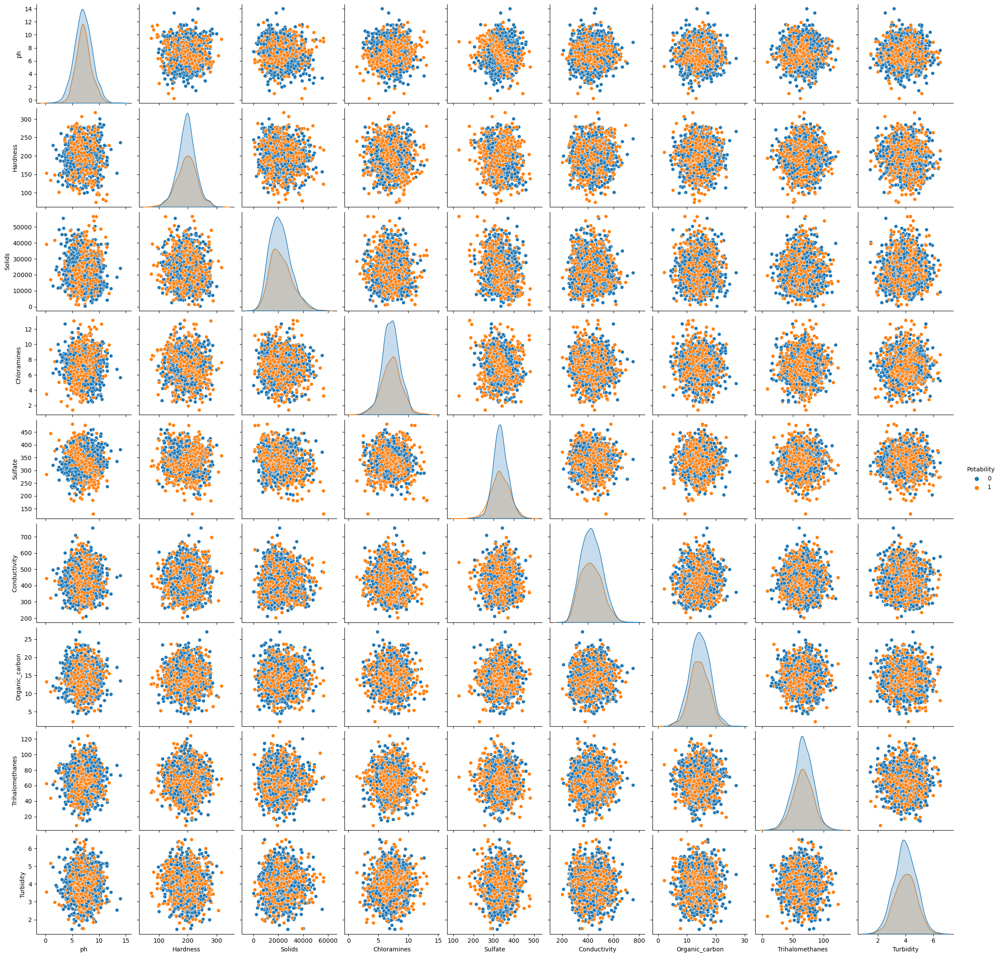

In [3]:
# Histograms of all features
df_clean.hist(figsize=(15, 15))
plt.tight_layout()
plt.show()

# Correlation heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(df_clean.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Box plots for each feature
df_clean.boxplot(figsize=(15, 10))
plt.title('Box Plots of Features')
plt.show()

# Pair plot
sns.pairplot(df_clean, hue='Potability')
plt.show()

In [4]:
# Separate features and target
X = df_clean.drop('Potability', axis=1)
y = df_clean['Potability']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [5]:
# Function to evaluate model
def evaluate_model(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    print(f"Accuracy: {accuracy_score(y_test, y_pred):.4f}")
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("Classification Report:")
    print(classification_report(y_test, y_pred))

# 1. Logistic Regression
print("Logistic Regression:")
lr_model = LogisticRegression(random_state=42)
evaluate_model(lr_model, X_train_scaled, X_test_scaled, y_train, y_test)

# 2. Random Forest
print("\nRandom Forest:")
rf_model = RandomForestClassifier(random_state=42)
evaluate_model(rf_model, X_train, X_test, y_train, y_test)

# 3. Support Vector Machine
print("\nSupport Vector Machine:")
svm_model = SVC(random_state=42)
evaluate_model(svm_model, X_train_scaled, X_test_scaled, y_train, y_test)

# 4. K-Nearest Neighbors
print("\nK-Nearest Neighbors:")
knn_model = KNeighborsClassifier()
evaluate_model(knn_model, X_train_scaled, X_test_scaled, y_train, y_test)

# 5. Neural Network (Multi-layer Perceptron)
print("\nNeural Network:")
nn_model = MLPClassifier(random_state=42, max_iter=1000)
evaluate_model(nn_model, X_train_scaled, X_test_scaled, y_train, y_test)

# 6. XGBoost
print("\nXGBoost:")
xgb_model = XGBClassifier(random_state=42)
evaluate_model(xgb_model, X_train, X_test, y_train, y_test)

Logistic Regression:
Accuracy: 0.5707
Confusion Matrix:
[[230   1]
 [172   0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.57      1.00      0.73       231
           1       0.00      0.00      0.00       172

    accuracy                           0.57       403
   macro avg       0.29      0.50      0.36       403
weighted avg       0.33      0.57      0.42       403


Random Forest:
Accuracy: 0.6526
Confusion Matrix:
[[194  37]
 [103  69]]
Classification Report:
              precision    recall  f1-score   support

           0       0.65      0.84      0.73       231
           1       0.65      0.40      0.50       172

    accuracy                           0.65       403
   macro avg       0.65      0.62      0.62       403
weighted avg       0.65      0.65      0.63       403


Support Vector Machine:
Accuracy: 0.6725
Confusion Matrix:
[[207  24]
 [108  64]]
Classification Report:
              precision    recall  f1-sco

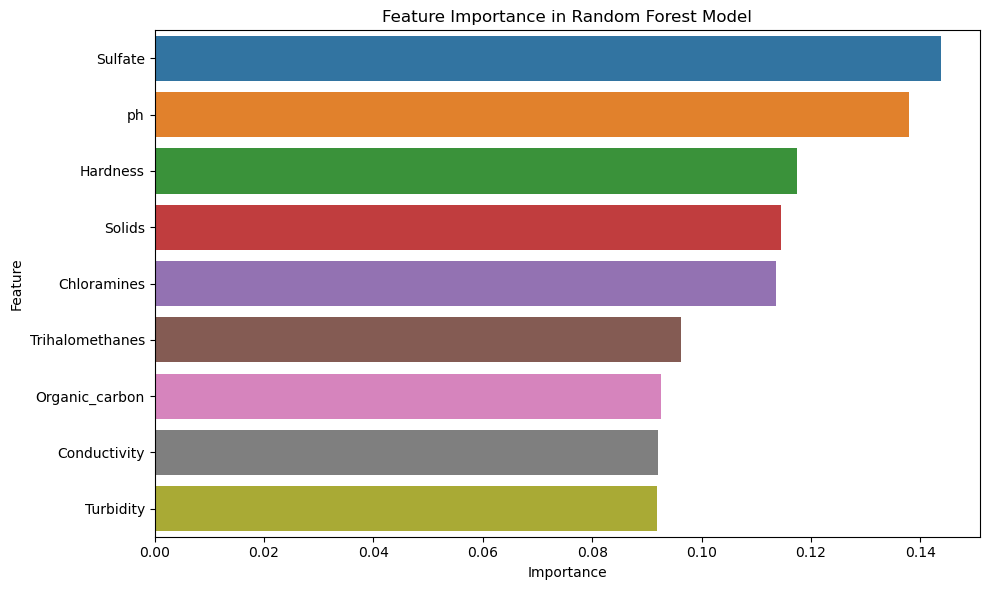

In [6]:
# Feature importance for Random Forest
importances = rf_model.feature_importances_
feature_imp = pd.DataFrame(sorted(zip(importances, X.columns), reverse=True), 
                           columns=['Importance', 'Feature'])

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_imp)
plt.title('Feature Importance in Random Forest Model')
plt.tight_layout()
plt.show()

In [7]:

# Convert 'Potability' to factor (categorical)
df_clean['Potability'] = df_clean['Potability'].astype('category')

C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\3334991425.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['Potability'] = df_clean['Potability'].astype('category')


C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

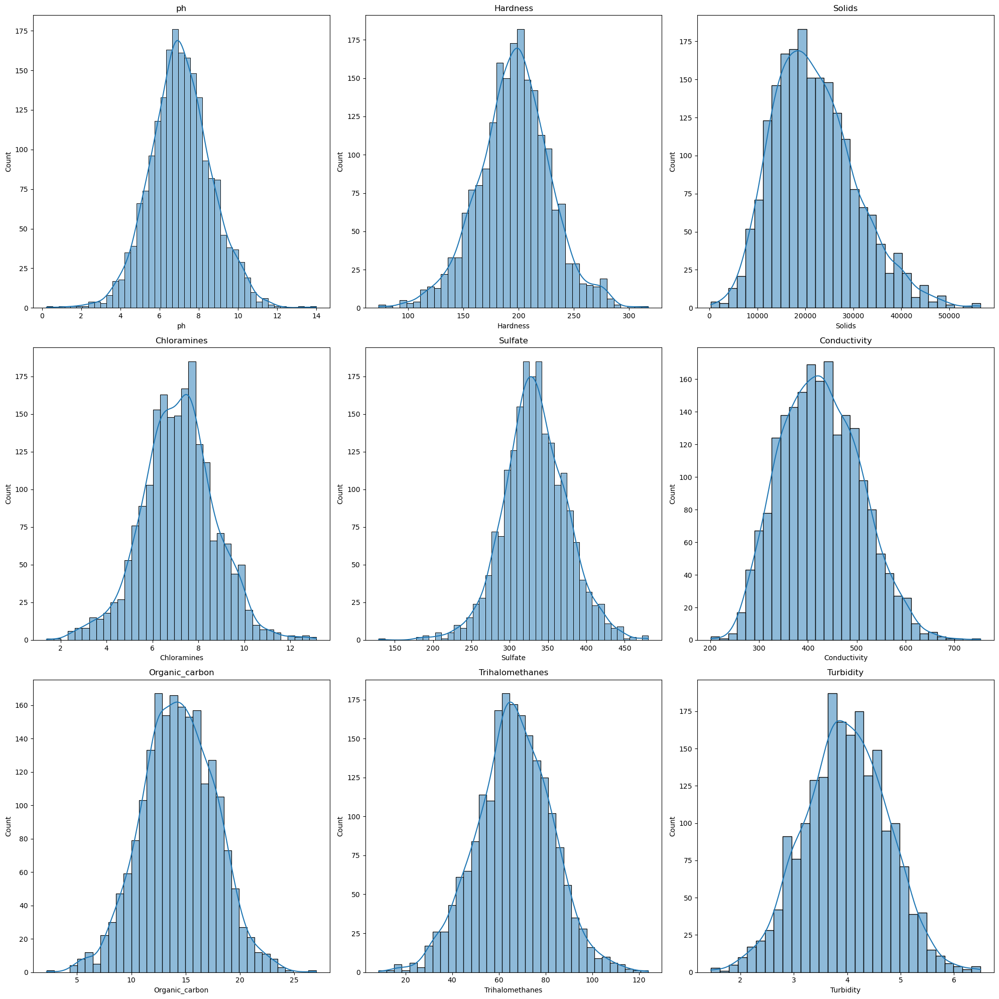

In [8]:
# Figure C: Histograms of the 9 predictor variables
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    sns.histplot(data=df_clean, x=col, ax=axes[i], kde=True)
    axes[i].set_title(col)

plt.tight_layout()
plt.show()



C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

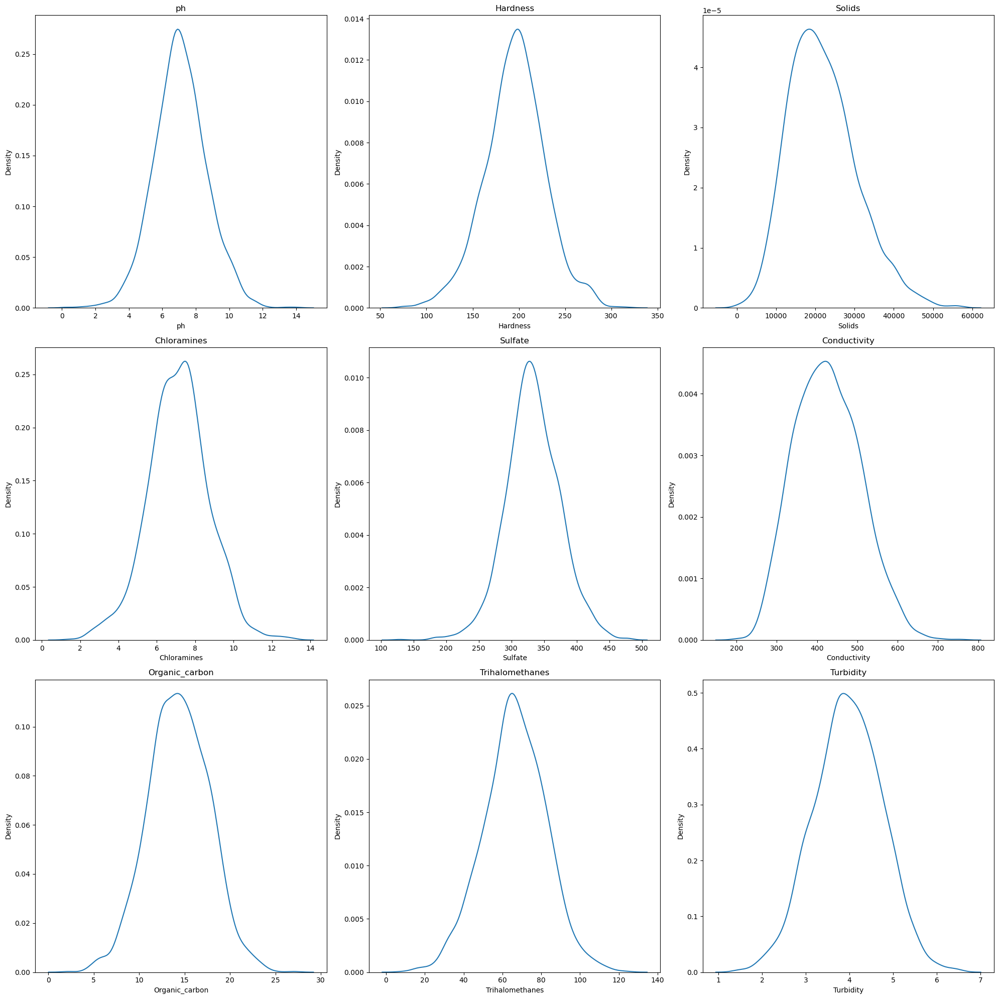

In [9]:
# Figure D: Density plots of the 9 variables
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    sns.kdeplot(data=df_clean, x=col, ax=axes[i])
    axes[i].set_title(col)

plt.tight_layout()
plt.show()



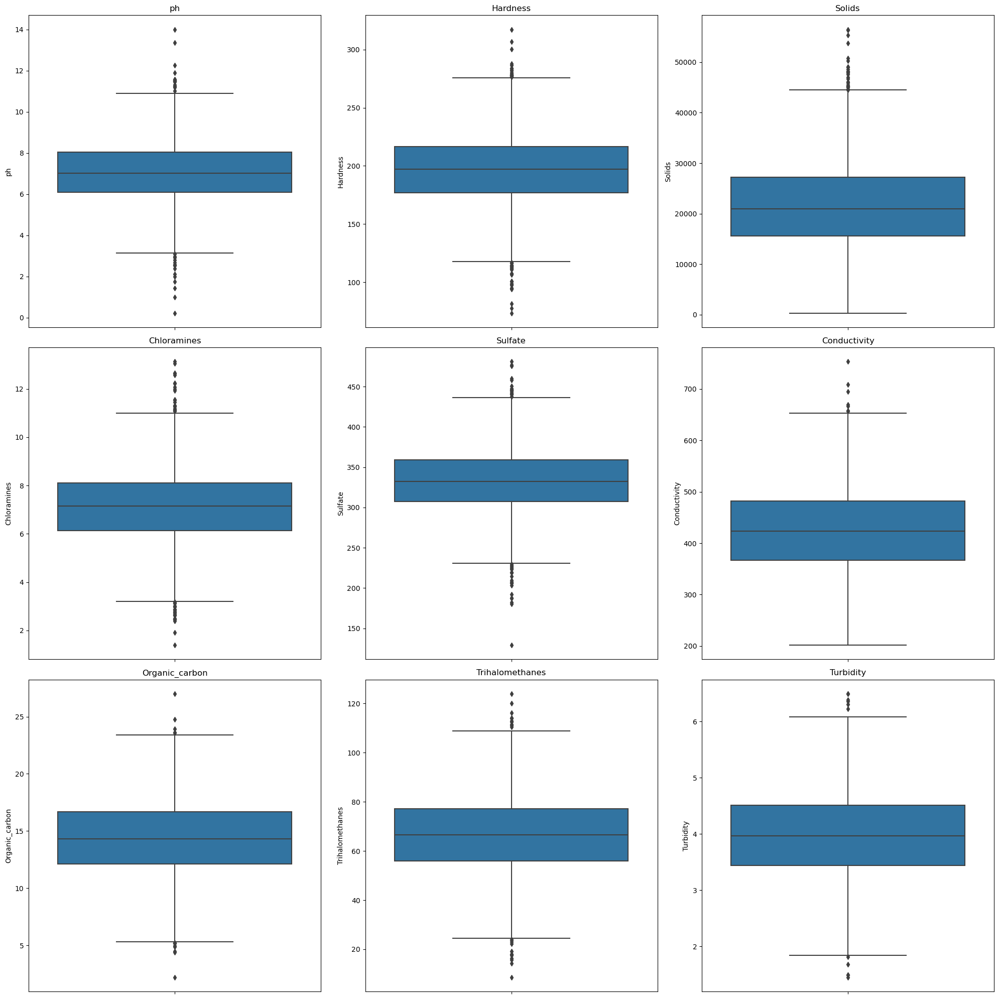

In [10]:
# Figure E: Box plots of the 9 variables for outlier detection
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    sns.boxplot(data=df_clean, y=col, ax=axes[i])
    axes[i].set_title(col)

plt.tight_layout()
plt.show()



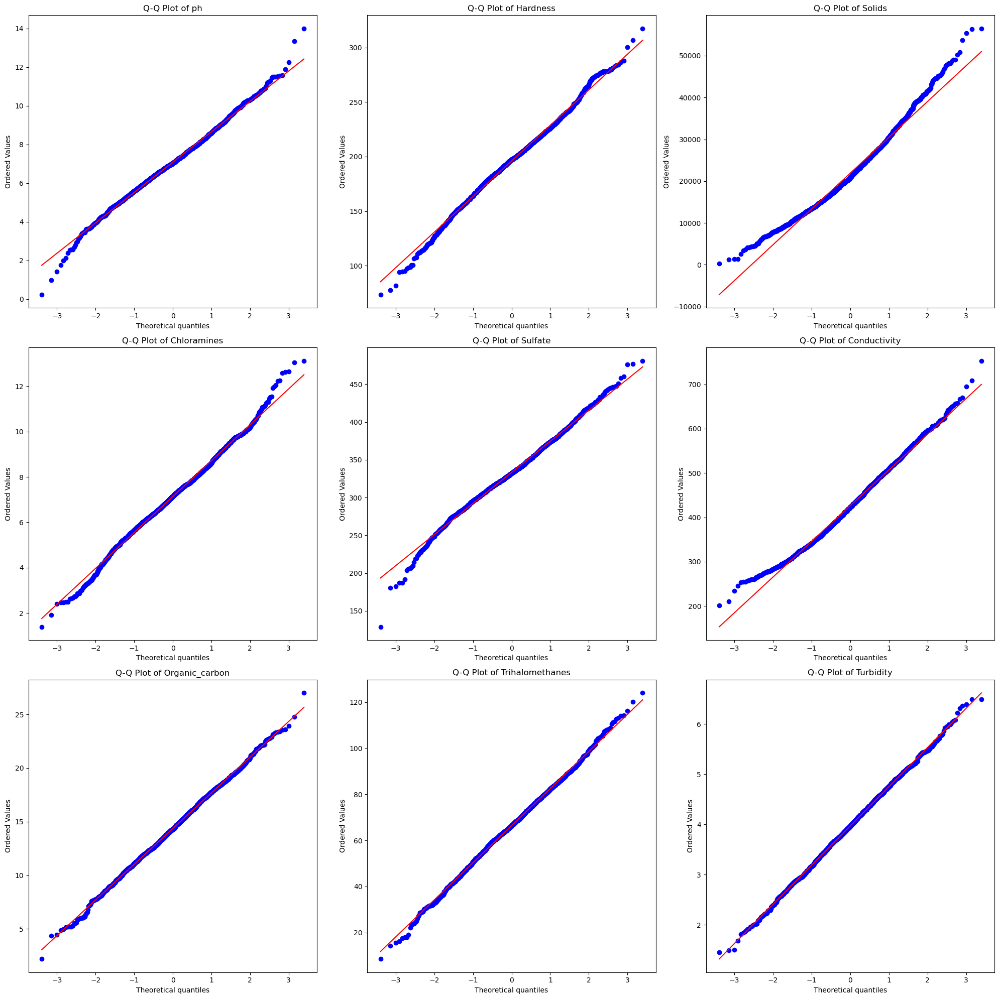

In [11]:
# Figure F: Normal QQ plots
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    stats.probplot(df_clean[col], dist="norm", plot=axes[i])
    axes[i].set_title(f"Q-Q Plot of {col}")

plt.tight_layout()
plt.show()



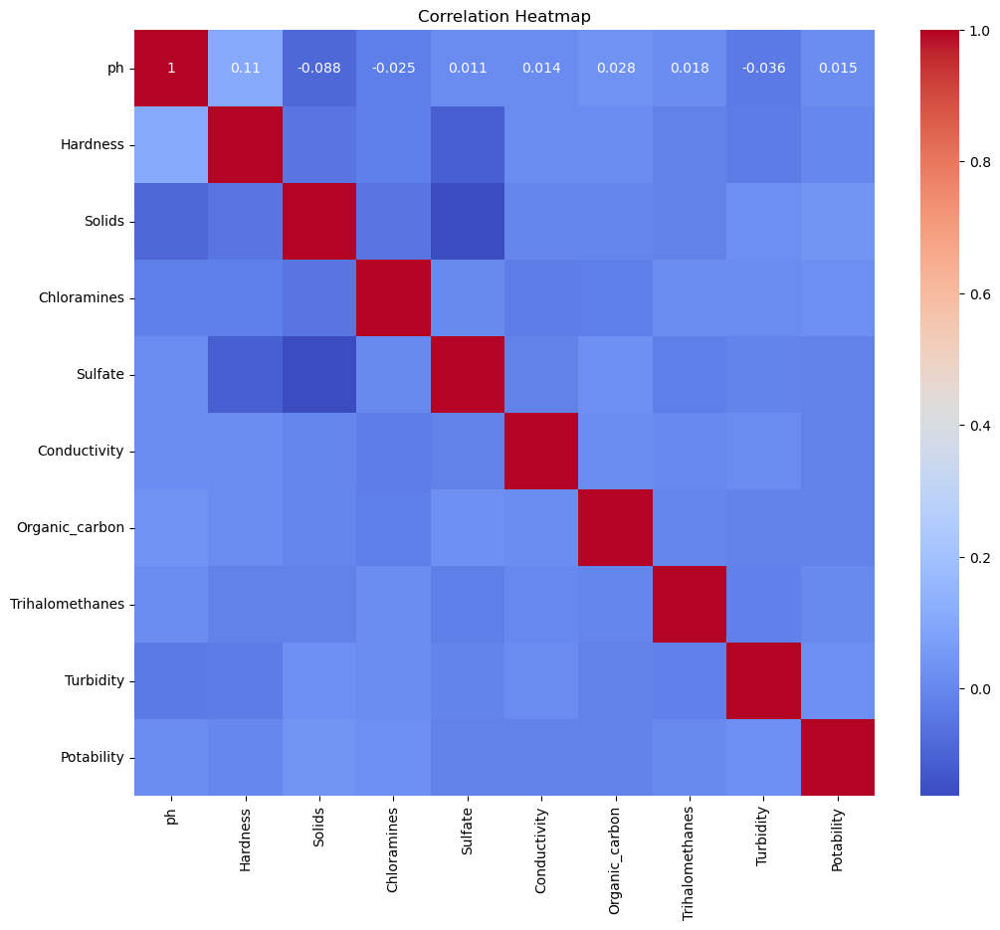

In [12]:
# Figure G: Correlations amongst variables
plt.figure(figsize=(12, 10))
sns.heatmap(df_clean.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()



C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning: The default of obser

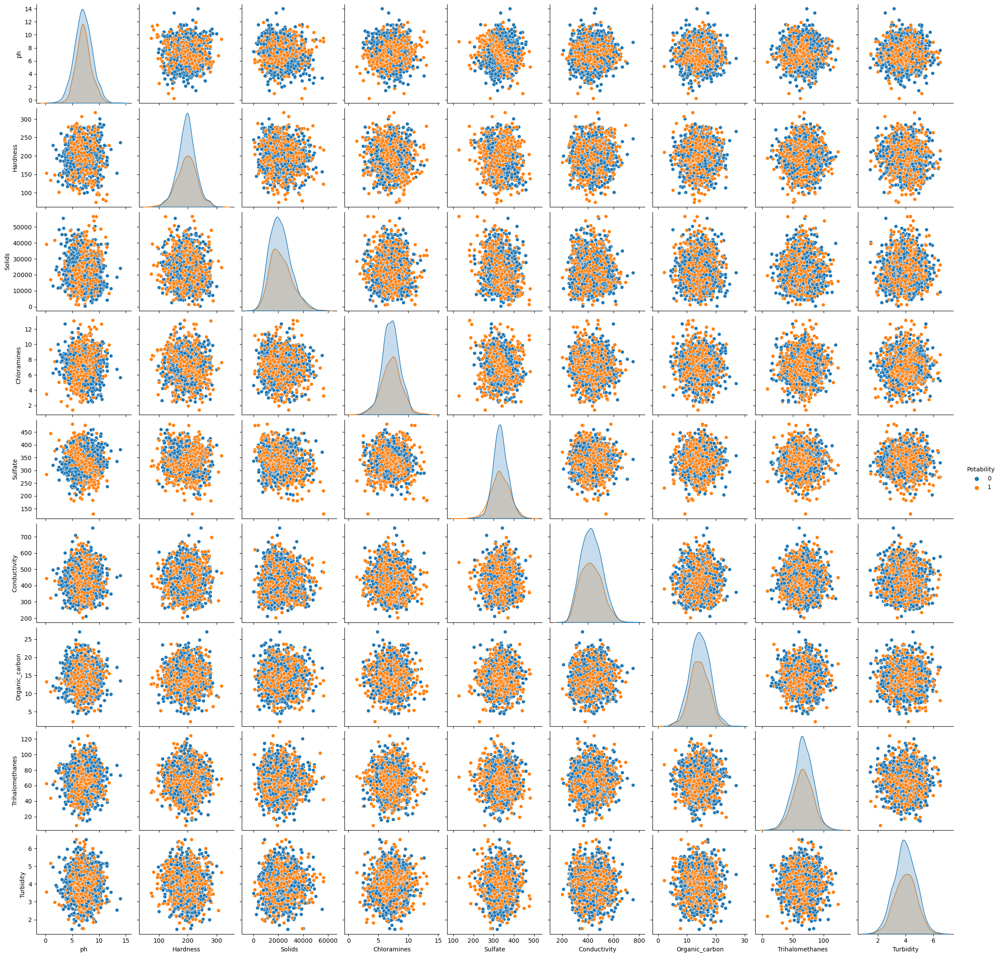

In [13]:
# Figure H: Scatterplot matrix of variables
sns.pairplot(df_clean, hue='Potability')
plt.show()

C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


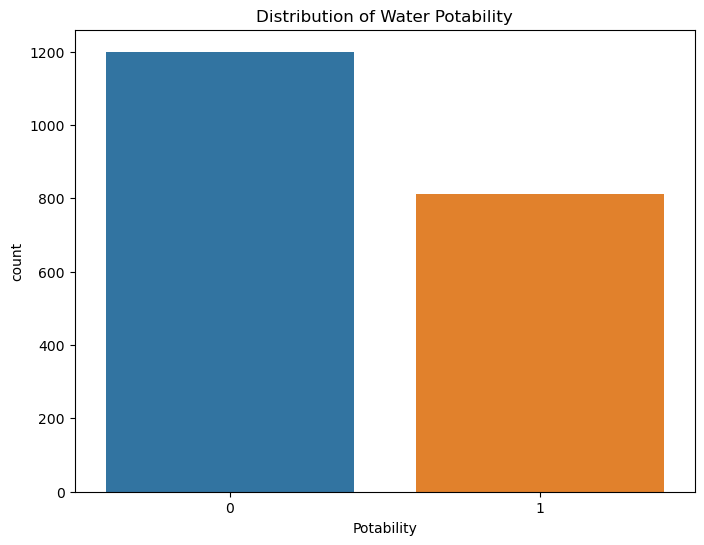

In [14]:
# Distribution of Potability
plt.figure(figsize=(8, 6))
sns.countplot(data=df_clean, x='Potability')
plt.title('Distribution of Water Potability')
plt.show()



C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and si

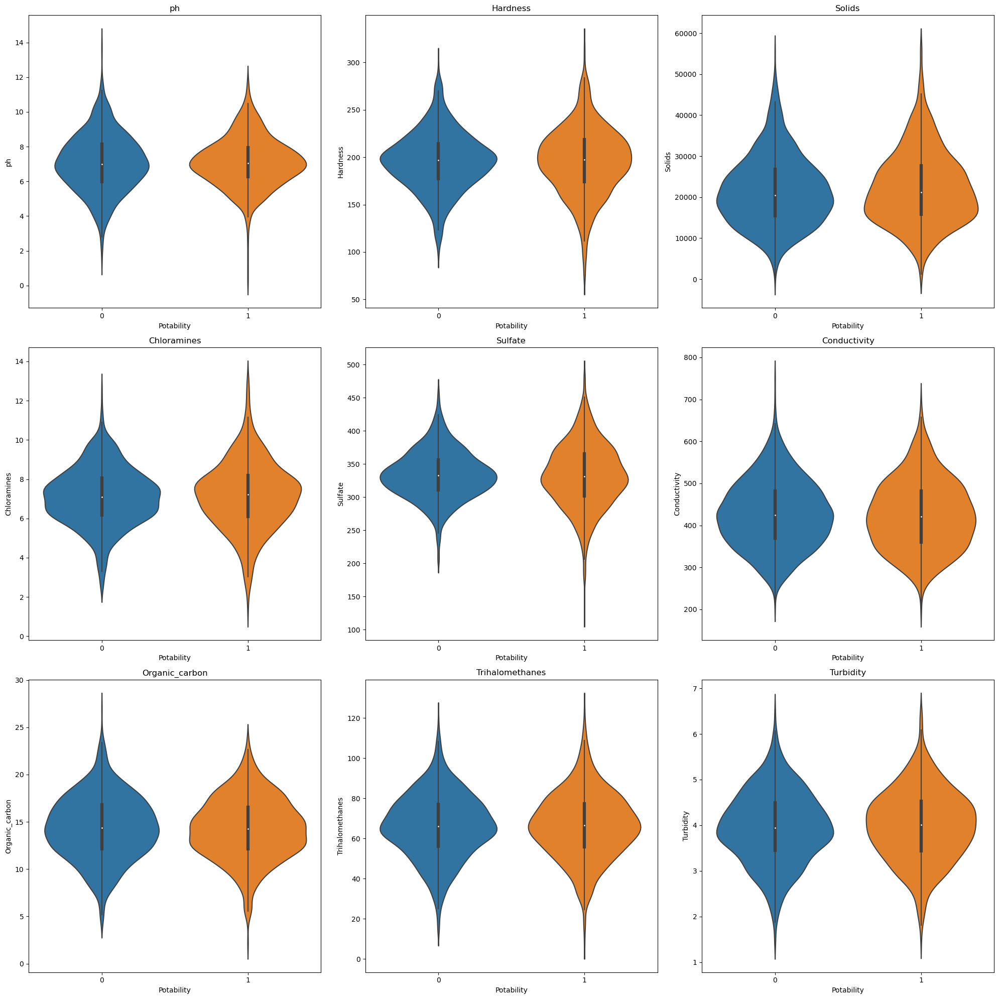

In [15]:
# Violin plots for each feature by Potability
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    sns.violinplot(data=df_clean, x='Potability', y=col, ax=axes[i])
    axes[i].set_title(col)

plt.tight_layout()
plt.show()



C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\888890139.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=df_clean[df_clean['Potability'] == 0], x=col, ax=axes[i], label='Not Potable', shade=True)
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\888890139.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=df_clean[df_clean['Potability'] == 1], x=col, ax=axes[i], label='Potable', shade=True)
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\sea

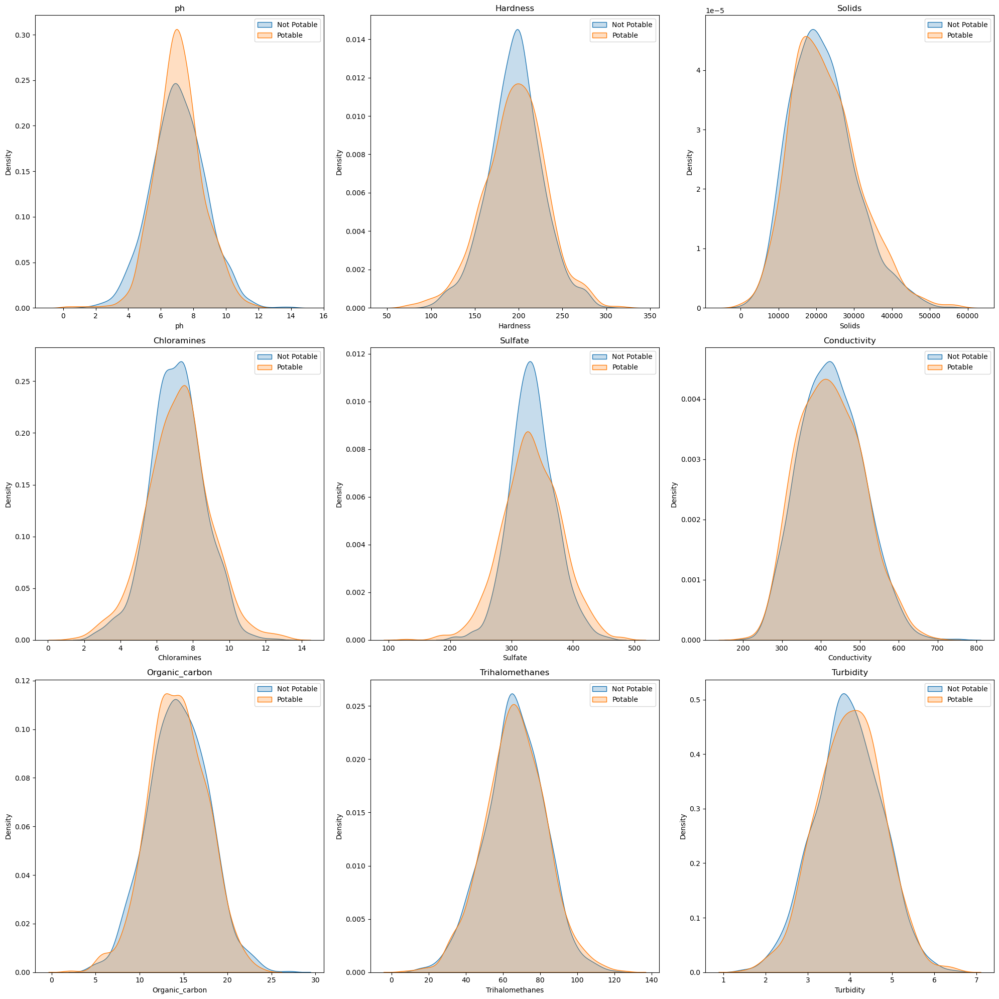

In [16]:
# Kernel Density Estimation (KDE) plots for each feature by Potability
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
axes = axes.ravel()

for i, col in enumerate(df_clean.columns[:-1]):  # Exclude 'Potability'
    sns.kdeplot(data=df_clean[df_clean['Potability'] == 0], x=col, ax=axes[i], label='Not Potable', shade=True)
    sns.kdeplot(data=df_clean[df_clean['Potability'] == 1], x=col, ax=axes[i], label='Potable', shade=True)
    axes[i].set_title(col)
    axes[i].legend()

plt.tight_layout()
plt.show()



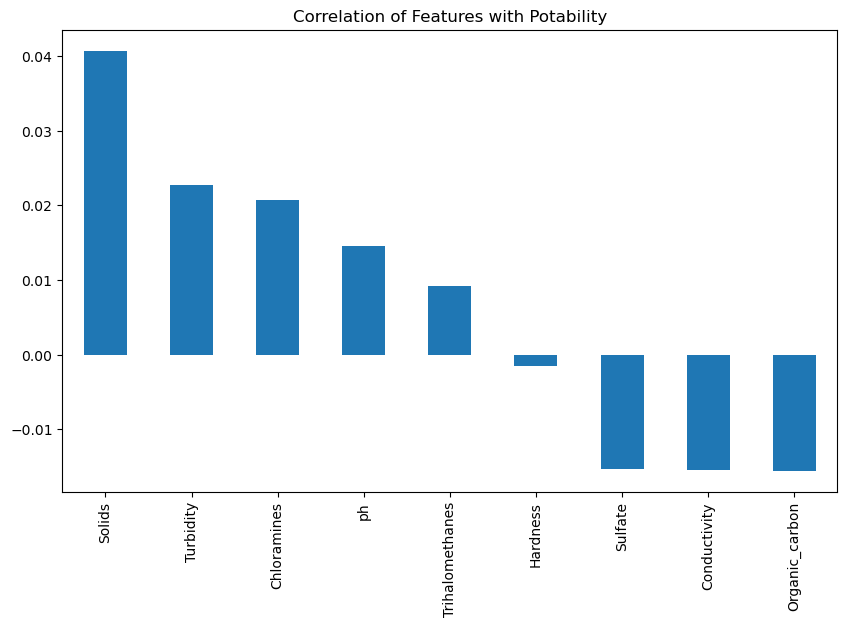

In [17]:
# Correlation with Potability
correlations = df_clean.corr()['Potability'].sort_values(ascending=False)
plt.figure(figsize=(10, 6))
correlations.drop('Potability').plot(kind='bar')
plt.title('Correlation of Features with Potability')
plt.show()



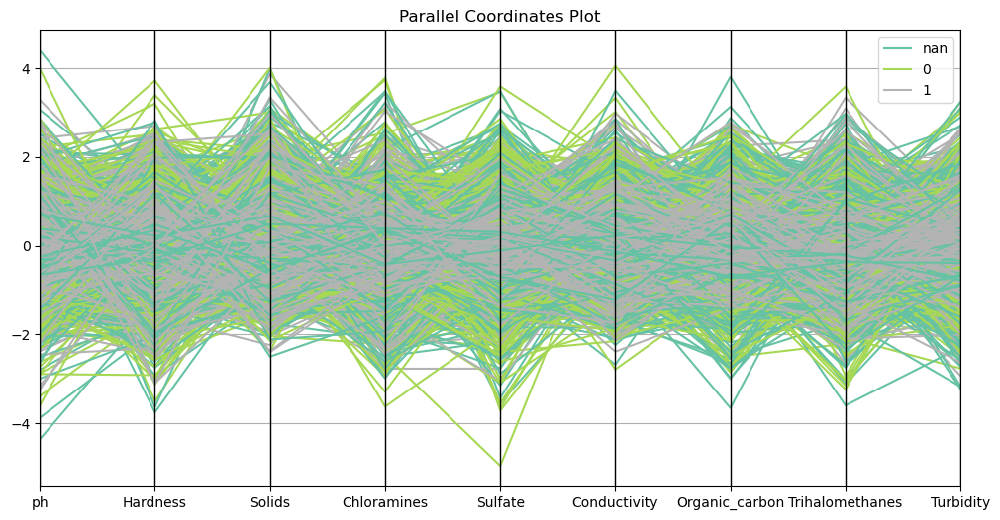

In [18]:
# Parallel Coordinates Plot
from sklearn.preprocessing import StandardScaler

# Standardize the features
scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df_clean.drop('Potability', axis=1)), 
                         columns=df_clean.columns[:-1])
df_scaled['Potability'] = df_clean['Potability']

plt.figure(figsize=(12, 6))
pd.plotting.parallel_coordinates(df_scaled, 'Potability', colormap=plt.get_cmap("Set2"))
plt.title('Parallel Coordinates Plot')
plt.show()



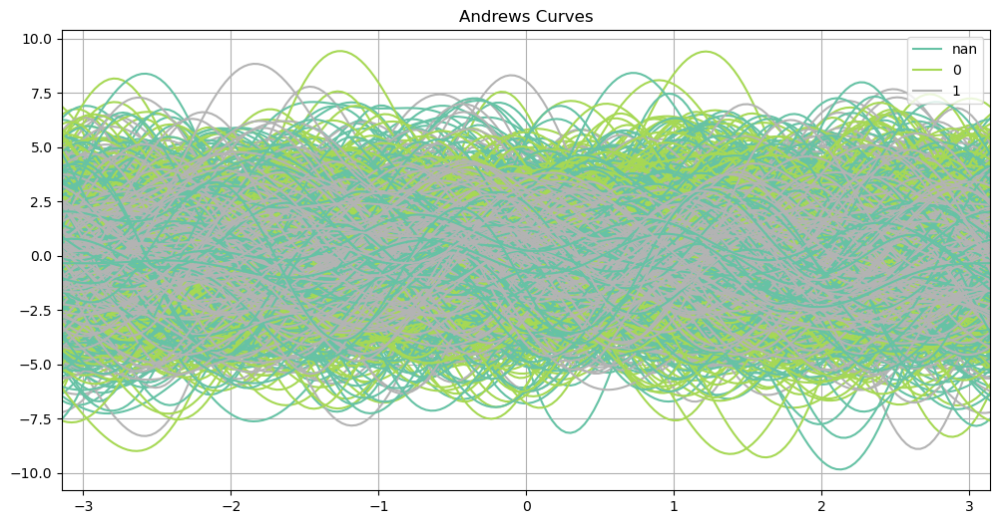

In [19]:
# Andrews Curves
from pandas.plotting import andrews_curves

plt.figure(figsize=(12, 6))
andrews_curves(df_scaled, 'Potability', colormap=plt.get_cmap("Set2"))
plt.title('Andrews Curves')
plt.show()



C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\2817203674.py:7: UserWarning: Ignoring `ax`; jointplot is a figure-level function.
  sns.jointplot(data=df_clean, x=feature, y='Potability', kind='hex', ax=axes[i])
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\2817203674.py:7: UserWarning: Ignoring `ax`; jointplot is a figure-level function.
  sns.jointplot(data=df_clean, x=feature, y='Potability', kind='hex', ax=axes[i])
C:\Users\E

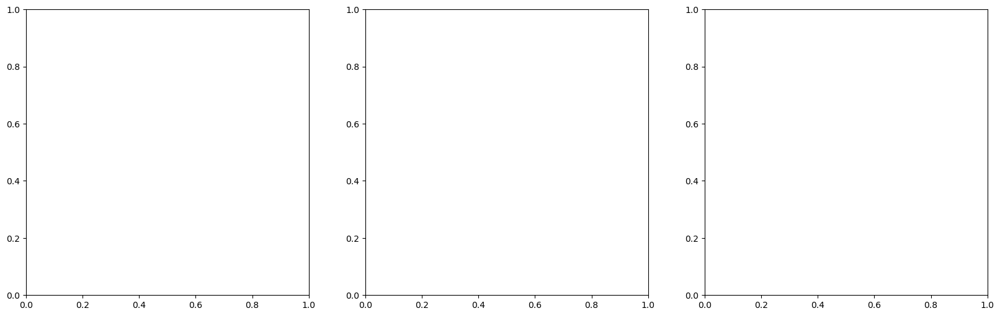

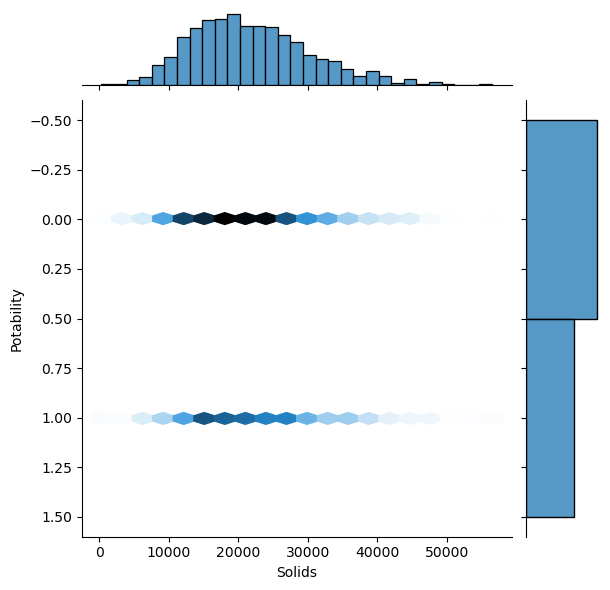

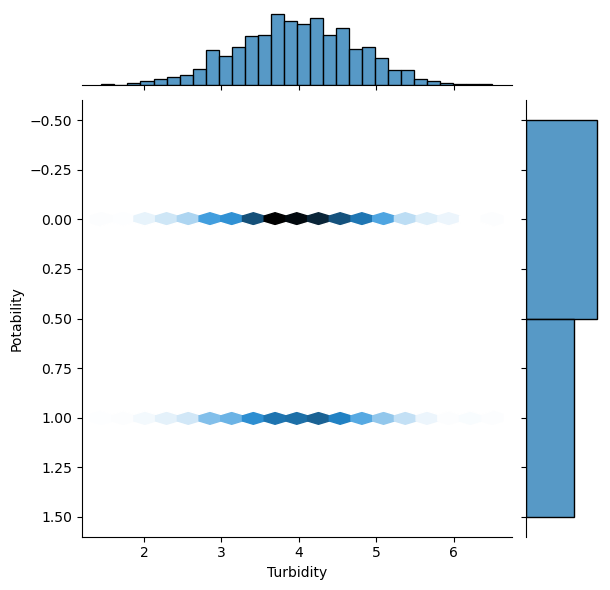

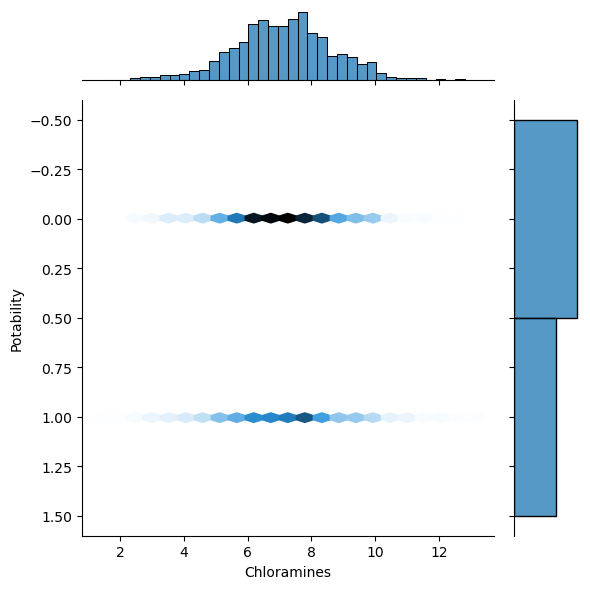

In [20]:
# Joint plots for top correlated features with Potability
top_corr_features = correlations.drop('Potability').nlargest(3).index

fig, axes = plt.subplots(1, 3, figsize=(20, 6))

for i, feature in enumerate(top_corr_features):
    sns.jointplot(data=df_clean, x=feature, y='Potability', kind='hex', ax=axes[i])

plt.tight_layout()
plt.show()



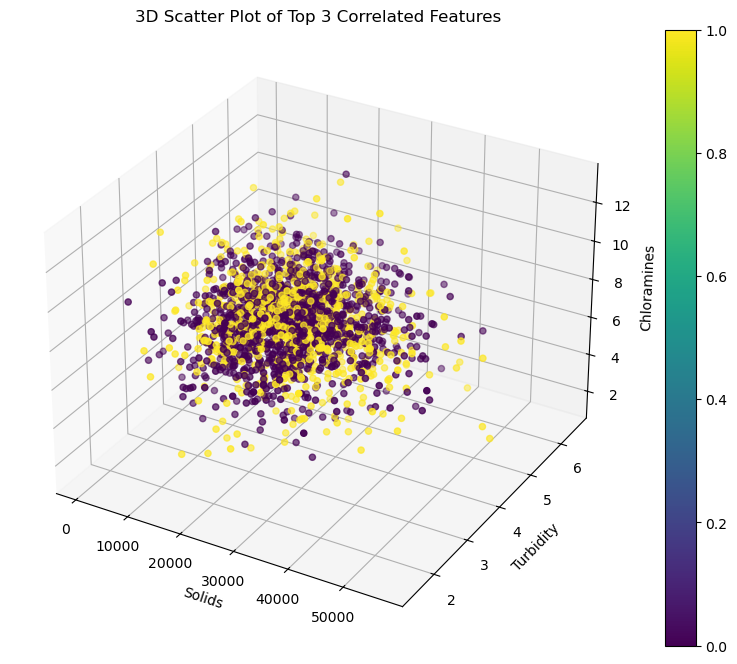

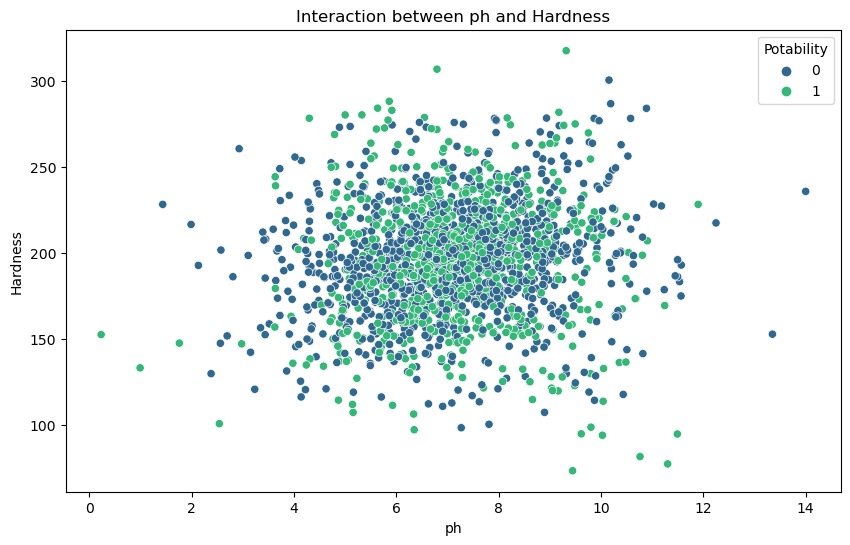

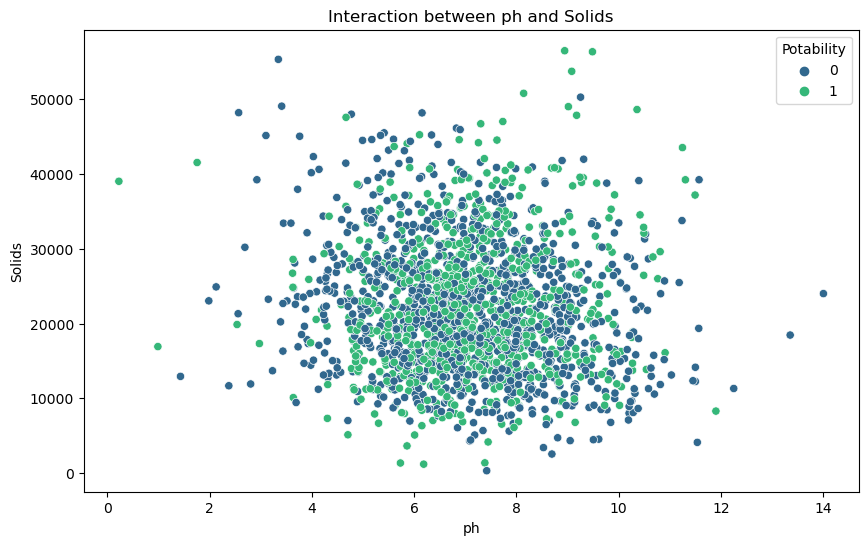

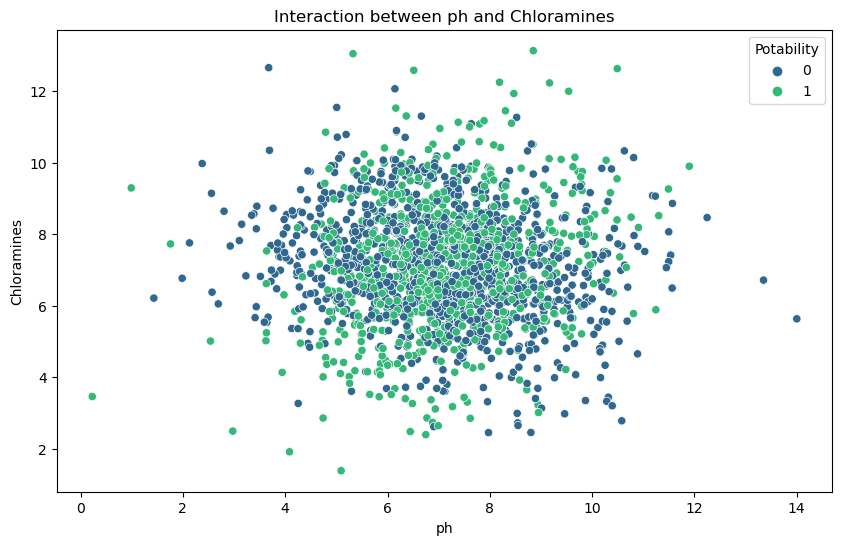

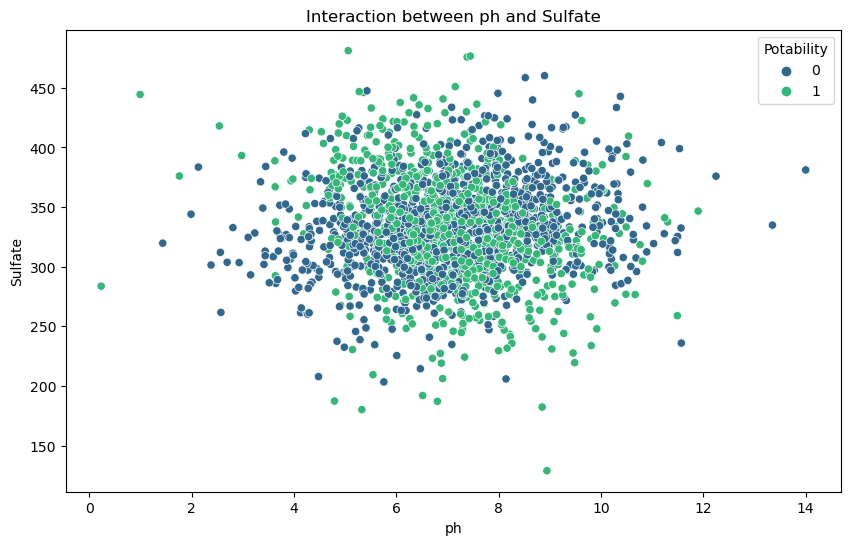

...

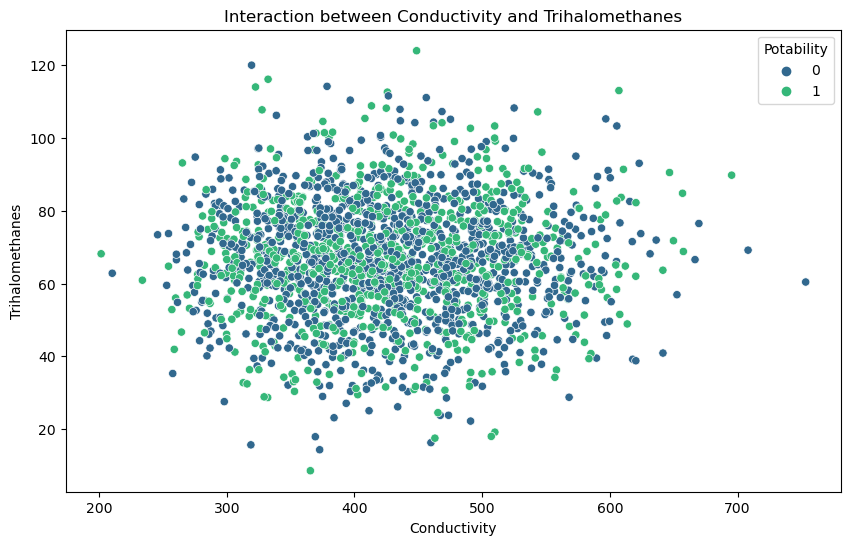

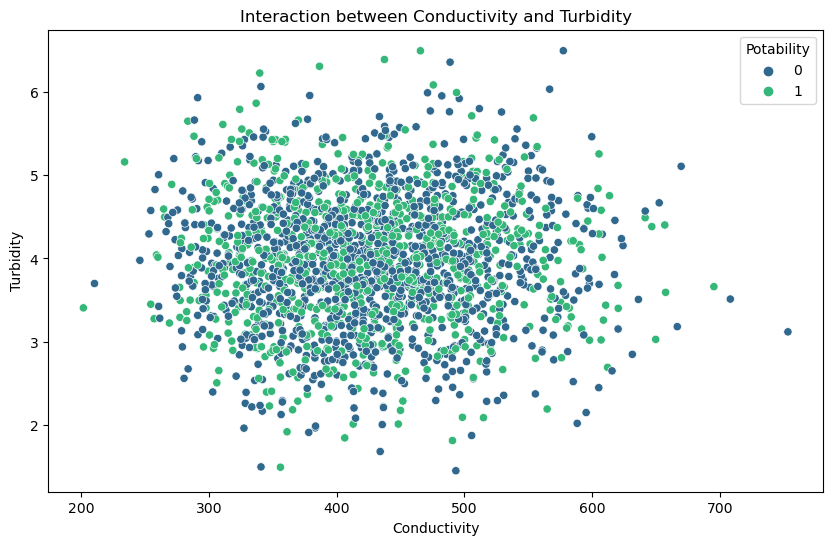

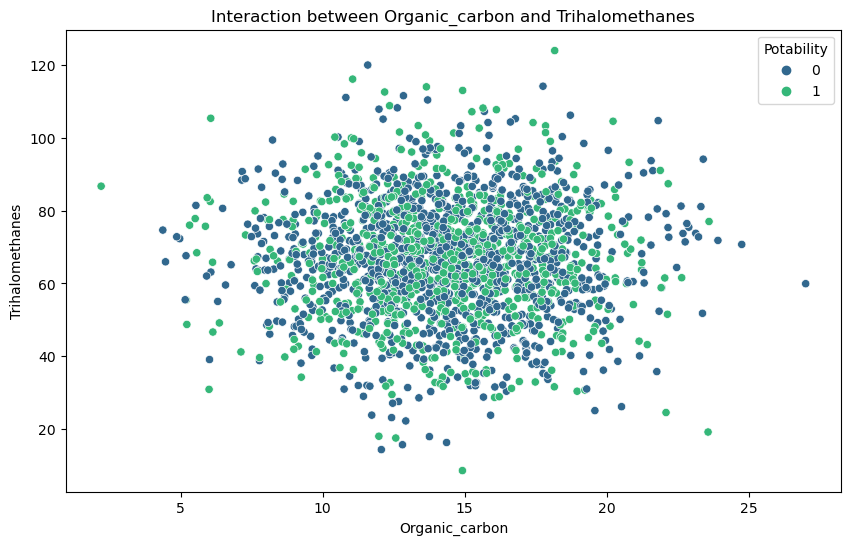

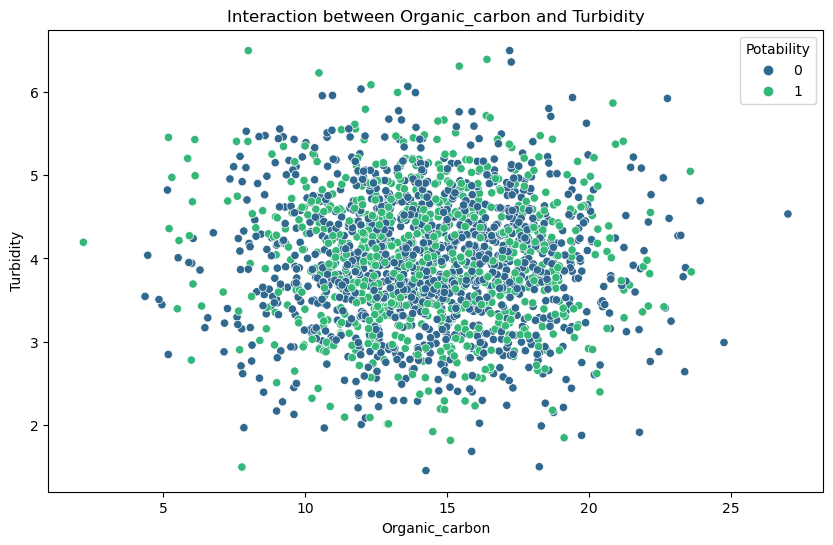

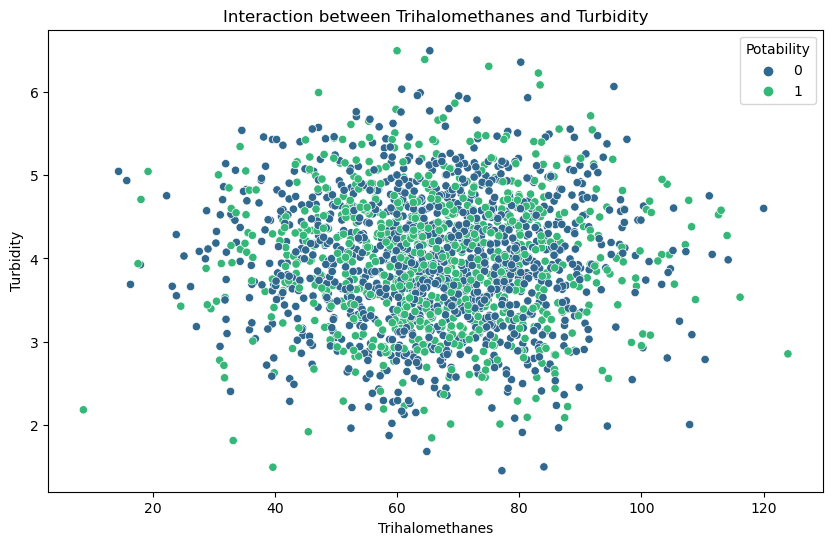

In [21]:
# 3D scatter plot of top 3 correlated features
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df_clean[top_corr_features[0]], 
                     df_clean[top_corr_features[1]], 
                     df_clean[top_corr_features[2]], 
                     c=df_clean['Potability'], 
                     cmap='viridis')

ax.set_xlabel(top_corr_features[0])
ax.set_ylabel(top_corr_features[1])
ax.set_zlabel(top_corr_features[2])
plt.colorbar(scatter)
plt.title('3D Scatter Plot of Top 3 Correlated Features')
plt.show()

# Feature interactions
for i, feature1 in enumerate(df_clean.columns[:-1]):
    for feature2 in df_clean.columns[i+1:-1]:
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=df_clean, x=feature1, y=feature2, hue='Potability', palette='viridis')
        plt.title(f'Interaction between {feature1} and {feature2}')
        plt.show()



C:\Users\Evans Sarker\AppData\Local\Temp\ipykernel_20508\2766221193.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['Cluster'] = clusters


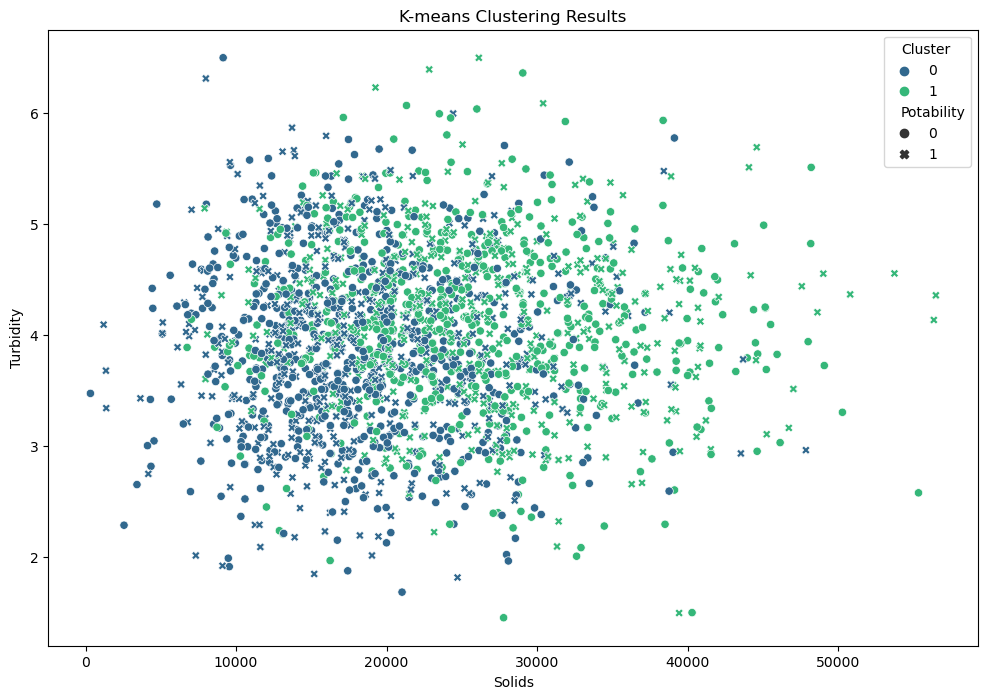

In [22]:
# Cluster analysis using K-means
from sklearn.cluster import KMeans

# Standardize the features
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_clean.drop('Potability', axis=1))

# Perform K-means clustering
kmeans = KMeans(n_clusters=2, random_state=42)
clusters = kmeans.fit_predict(df_scaled)

# Add cluster labels to the dataframe
df_clean['Cluster'] = clusters

# Visualize clusters
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df_clean, x=top_corr_features[0], y=top_corr_features[1], 
                hue='Cluster', style='Potability', palette='viridis')
plt.title('K-means Clustering Results')
plt.show()



Cluster vs Potability:
Potability    0    1
Cluster             
0           633  412
1           567  399


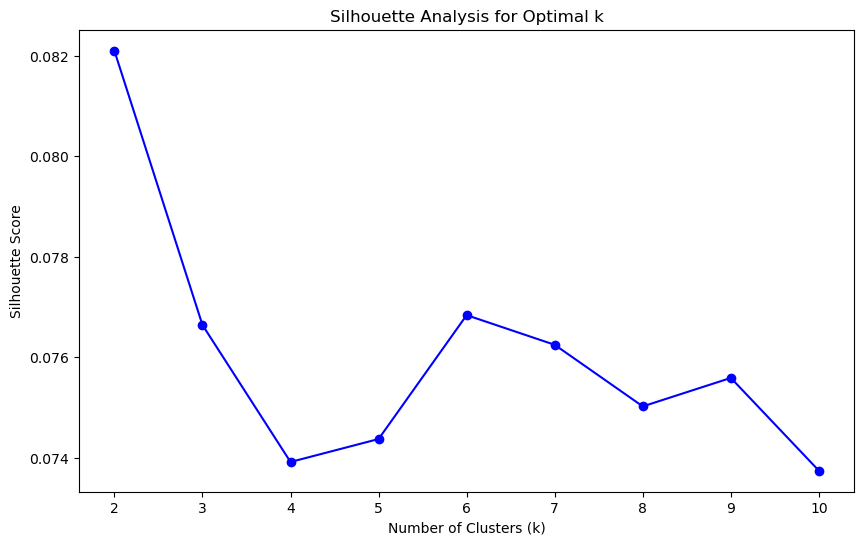

In [23]:
# Compare cluster labels with actual Potability
cluster_potability = pd.crosstab(df_clean['Cluster'], df_clean['Potability'])
print("Cluster vs Potability:")
print(cluster_potability)

# Silhouette analysis for optimal number of clusters
from sklearn.metrics import silhouette_score

silhouette_scores = []
k_range = range(2, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    clusters = kmeans.fit_predict(df_scaled)
    silhouette_scores.append(silhouette_score(df_scaled, clusters))

plt.figure(figsize=(10, 6))
plt.plot(k_range, silhouette_scores, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Analysis for Optimal k')
plt.show()

In [24]:
# Suggested Modeling based on Dr Fadahunsi's feedback
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import GradientBoostingClassifier, StackingClassifier, VotingClassifier, RandomForestClassifier
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score, learning_curve
import numpy as np
import pandas as pd


In [25]:
lda = LinearDiscriminantAnalysis()
evaluate_model(lda, X_train_scaled, X_test_scaled, y_train, y_test)


Accuracy: 0.5707
Confusion Matrix:
[[230   1]
 [172   0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.57      1.00      0.73       231
           1       0.00      0.00      0.00       172

    accuracy                           0.57       403
   macro avg       0.29      0.50      0.36       403
weighted avg       0.33      0.57      0.42       403



In [26]:
qda = QuadraticDiscriminantAnalysis()
evaluate_model(qda, X_train_scaled, X_test_scaled, y_train, y_test)


Accuracy: 0.6873
Confusion Matrix:
[[206  25]
 [101  71]]
Classification Report:
              precision    recall  f1-score   support

           0       0.67      0.89      0.77       231
           1       0.74      0.41      0.53       172

    accuracy                           0.69       403
   macro avg       0.71      0.65      0.65       403
weighted avg       0.70      0.69      0.67       403



In [27]:
gnb = GaussianNB()
evaluate_model(gnb, X_train_scaled, X_test_scaled, y_train, y_test)


Accuracy: 0.6228
Confusion Matrix:
[[209  22]
 [130  42]]
Classification Report:
              precision    recall  f1-score   support

           0       0.62      0.90      0.73       231
           1       0.66      0.24      0.36       172

    accuracy                           0.62       403
   macro avg       0.64      0.57      0.54       403
weighted avg       0.63      0.62      0.57       403



In [28]:
gbc = GradientBoostingClassifier(random_state=42)
evaluate_model(gbc, X_train, X_test, y_train, y_test)


Accuracy: 0.6427
Confusion Matrix:
[[199  32]
 [112  60]]
Classification Report:
              precision    recall  f1-score   support

           0       0.64      0.86      0.73       231
           1       0.65      0.35      0.45       172

    accuracy                           0.64       403
   macro avg       0.65      0.61      0.59       403
weighted avg       0.65      0.64      0.61       403



In [29]:
base_models = [
    ('rf', RandomForestClassifier(random_state=42)),
    ('svm', SVC(random_state=42)),
    ('gbc', GradientBoostingClassifier(random_state=42))
]

stacking_model = StackingClassifier(
    estimators=base_models,
    final_estimator=LogisticRegression(random_state=42),
    cv=5
)

evaluate_model(stacking_model, X_train_scaled, X_test_scaled, y_train, y_test)


Accuracy: 0.6849
Confusion Matrix:
[[198  33]
 [ 94  78]]
Classification Report:
              precision    recall  f1-score   support

           0       0.68      0.86      0.76       231
           1       0.70      0.45      0.55       172

    accuracy                           0.68       403
   macro avg       0.69      0.66      0.65       403
weighted avg       0.69      0.68      0.67       403



In [31]:
rfe_selector = RFE(estimator=RandomForestClassifier(random_state=42), n_features_to_select=5, step=1)
rfe_selector = rfe_selector.fit(X_train_scaled, y_train)

# Get the selected features
selected_features = X.columns[rfe_selector.support_]
print("Selected features:", selected_features)


Selected features: Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate'], dtype='object')


In [32]:
X_train_rfe = X_train_scaled[:, rfe_selector.support_]
X_test_rfe = X_test_scaled[:, rfe_selector.support_]

# Example: Random Forest with selected features
rf_rfe = RandomForestClassifier(random_state=42)
evaluate_model(rf_rfe, X_train_rfe, X_test_rfe, y_train, y_test)


Accuracy: 0.6551
Confusion Matrix:
[[181  50]
 [ 89  83]]
Classification Report:
              precision    recall  f1-score   support

           0       0.67      0.78      0.72       231
           1       0.62      0.48      0.54       172

    accuracy                           0.66       403
   macro avg       0.65      0.63      0.63       403
weighted avg       0.65      0.66      0.65       403



In [33]:
from sklearn.model_selection import cross_val_score

# Example: Cross-validation with Random Forest
rf_cv = RandomForestClassifier(random_state=42)
cv_scores = cross_val_score(rf_cv, X_train_scaled, y_train, cv=5)

print("Cross-validation scores:", cv_scores)
print("Mean CV score:", cv_scores.mean())


Cross-validation scores: [0.6863354  0.6552795  0.66770186 0.66666667 0.67601246]
Mean CV score: 0.6703991795824383
